#***Detector de Matriculas con Visión Artificial***
Autores del trabajo: Pablo López Martínez, David Valls Lozano y Daniel Ventura González


En este proyecto hemos desarrollado una serie de modelos de detección de matrículas basados en diferentes métodos de procesado de imágenes.

# **Detector** **Manual**

Este método se basa en la conversión de la imagen a escala de grises, para posteriormente obtener los contornos de la imagen e intentar localizar polígonos que aproximadente coincidan con la forma de una matrícula.

Utiliza como paquetes principales OpenCV y imutils para la mayoría de las funciones del método, junto a otros paquetes básicos.

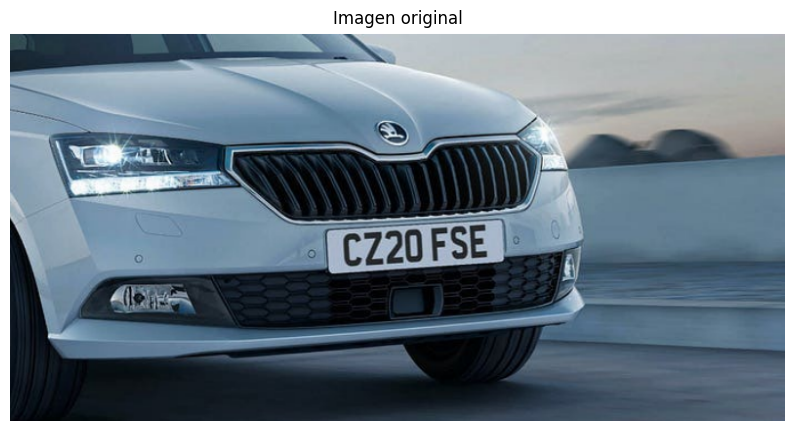

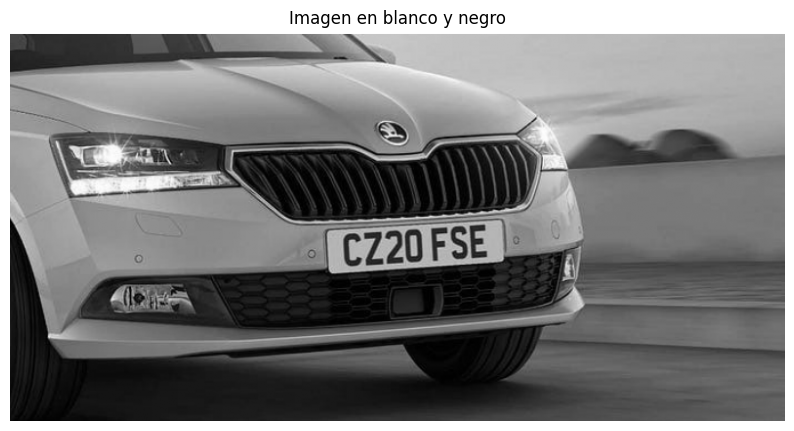

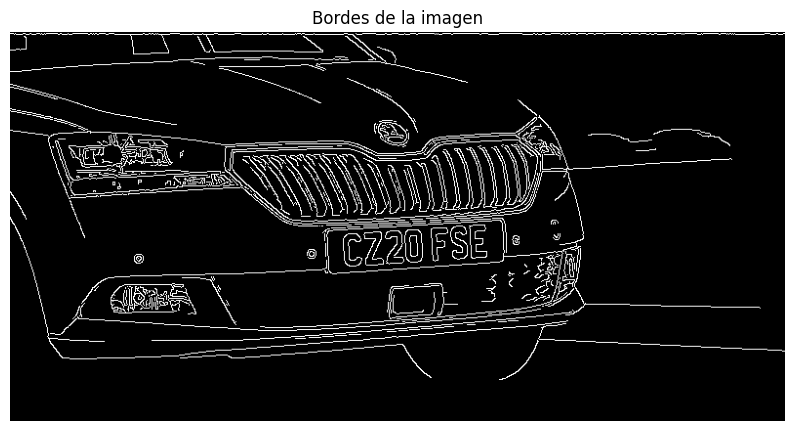

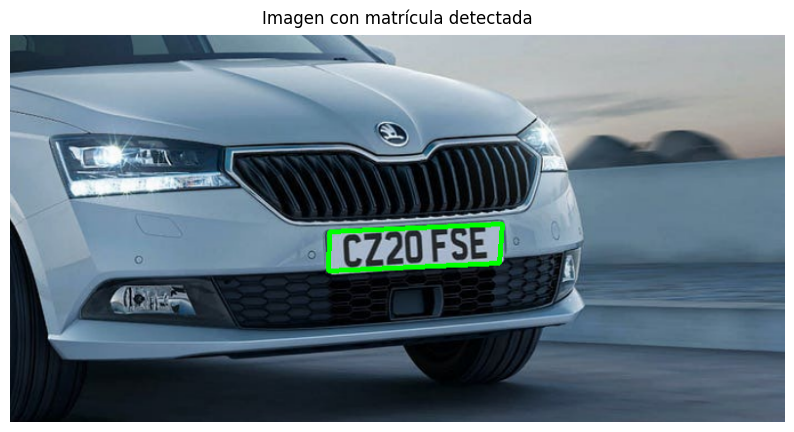

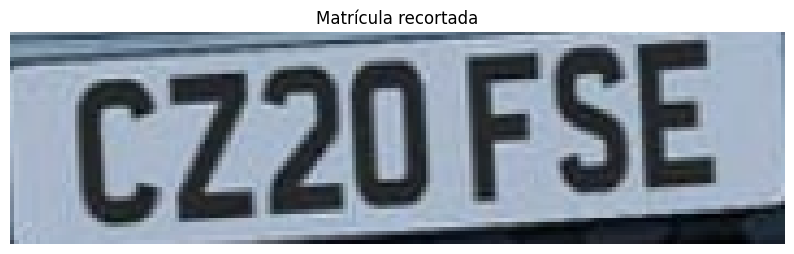

...

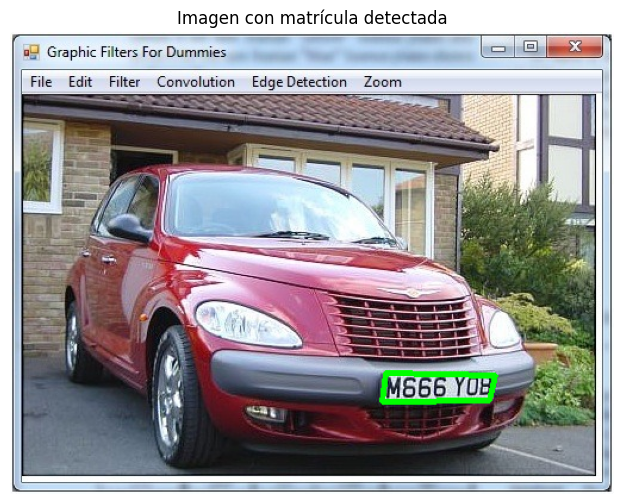

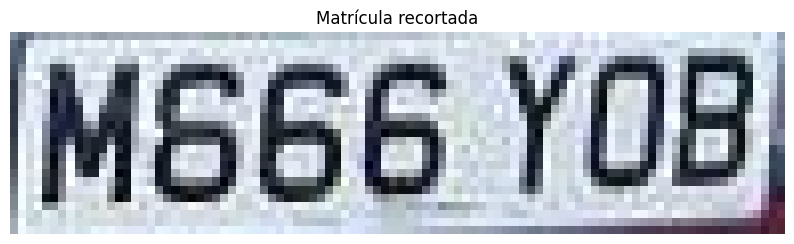

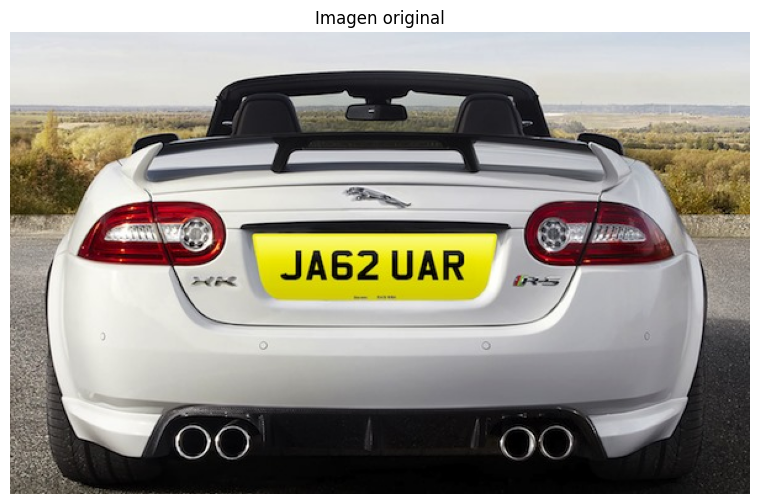

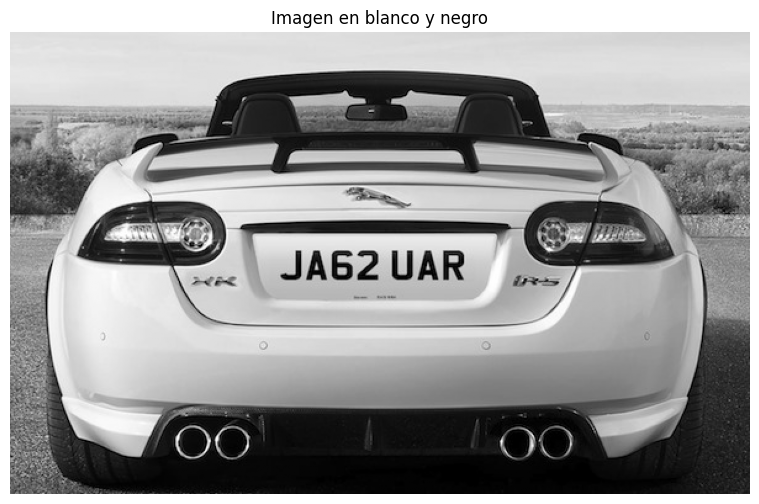

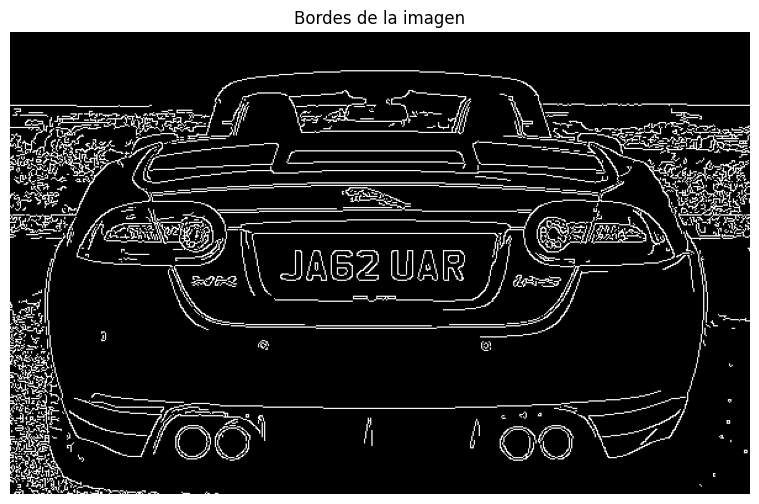

No se pudo detectar la matrícula.


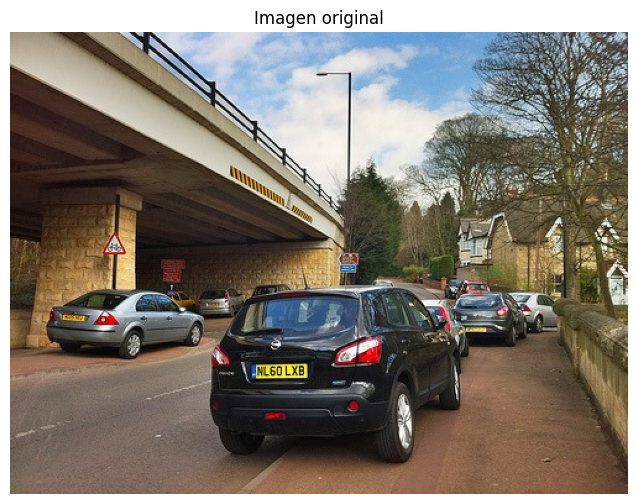

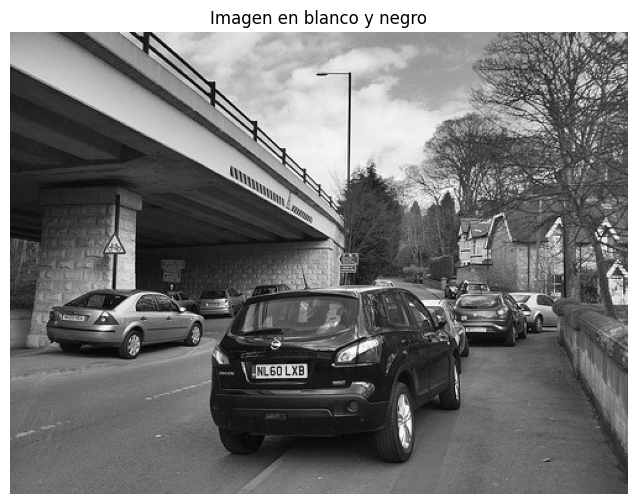

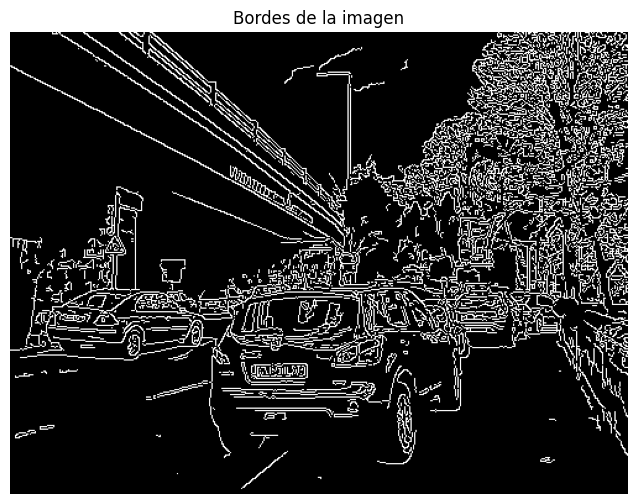

No se pudo detectar la matrícula.


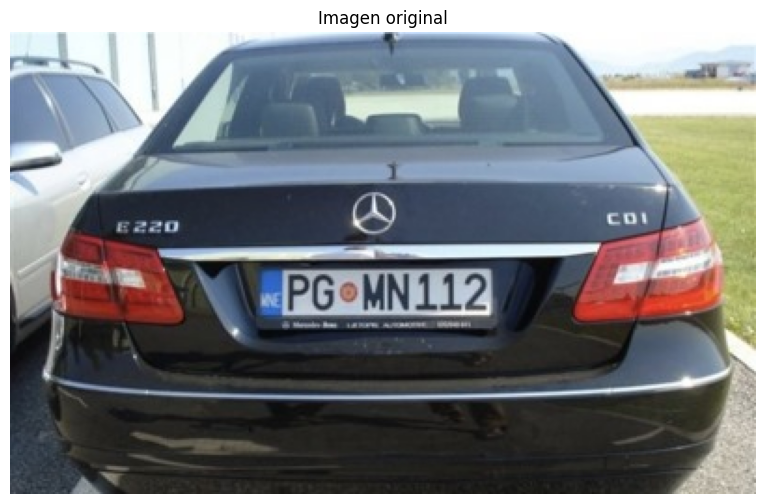

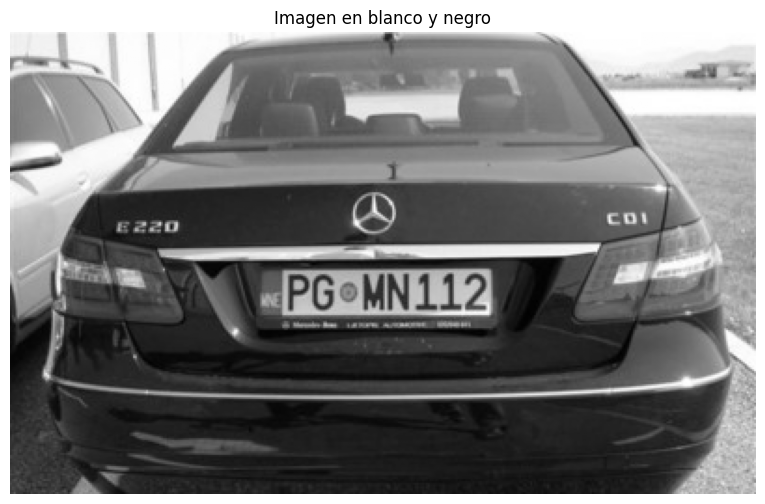

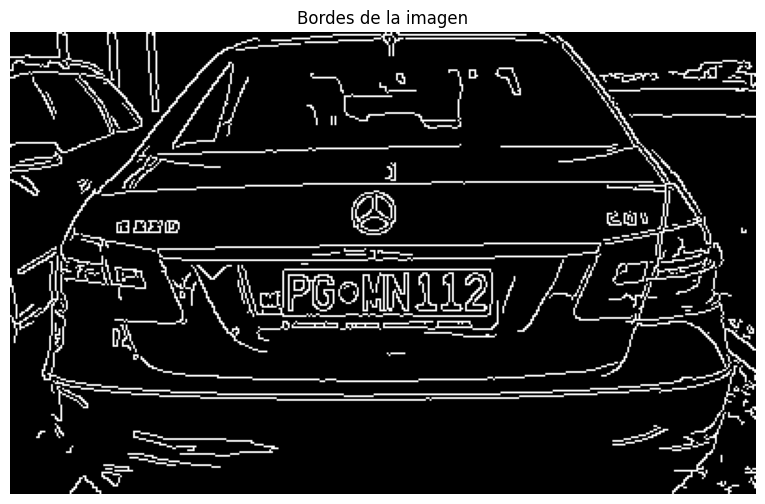

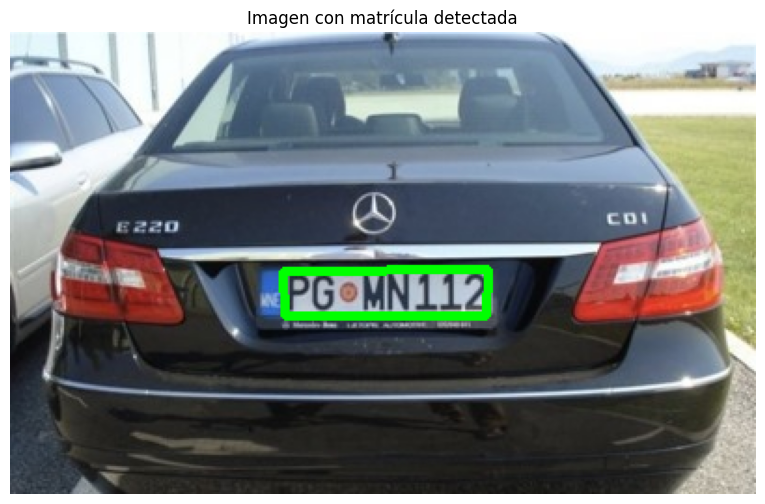

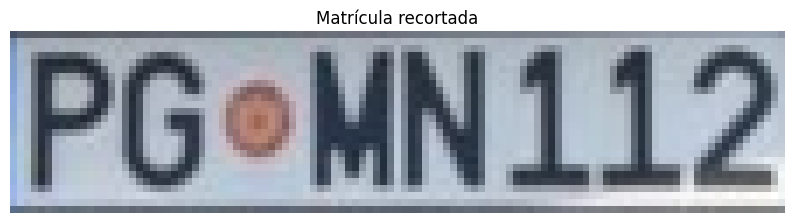

In [ ]:
import cv2
import imutils
import numpy as np
import matplotlib.pyplot as plt # Se importan los paquetes.


# Función para visualizar las diferentes imágenes.
def mostrar_imagen(titulo, imagen, cmap=None):
    plt.figure(figsize=(10,6))
    plt.title(titulo)
    if cmap:
        plt.imshow(imagen, cmap=cmap)
    else:
        plt.imshow(cv2.cvtColor(imagen, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()


# Lista con todas las imágenes.
coches = ['matriculas.png', 'matriculas1.jpg', 'matriculas2.jpg',  'coche1.jpeg', 'coche2.jpeg', 'coche3.jpeg', 'coche4.jpeg']

# Bucle para buscar la matrícula en todas las imágenes.
for i in coches:
    ruta_imagen = i  # Se asigna la ruta a cada imagen.
    imagen = cv2.imread(ruta_imagen)
    gris = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY) # Se lee la imagen y se pasa a blanco y negro.
    mostrar_imagen('Imagen original', imagen)
    mostrar_imagen('Imagen en blanco y negro', gris, cmap='gray')

    bordes = cv2.Canny(gris, 100, 200) # Se detctan los bordes con un filtro Canny.
    mostrar_imagen('Bordes de la imagen', bordes, cmap='gray')

    # Se encuentran y extraen los contornos de la imagen (jerarquía de contornos y puntos que los forman).
    contornos = cv2.findContours(bordes.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contornos = imutils.grab_contours(contornos)

    # Se seleccionan los 30 más grandes y se ordenan de mayor a menor.
    contornos = sorted(contornos, key=cv2.contourArea, reverse=True)[:30]

    matricula = None

    # Se buscan los contornos con 4 lados y con proporciones similares a la de una matrícula.
    for cnt in contornos:
        peri = cv2.arcLength(cnt, True) # Se calcula el perímetro cerrado del controno.
        approx = cv2.approxPolyDP(cnt, 0.018 * peri, True) # Se aproxima el contorno a una forma poligonal.

        # Si el contorno tiene 4 puntos se calcula el rectángulo que encierra ese contorno.
        if len(approx) == 4:
            x, y, w, h = cv2.boundingRect(approx)
            aspecto = w / float(h) # Proporción entre ancho y alto.
            area = cv2.contourArea(cnt) # Área del rectángulo.

            # Si la relación de aspecto y el área cumplen los requisitos se guarda la matrícula.
            if 2 < aspecto < 6 and area > 1500:
                matricula = approx
                break

    # Si se detecta la matrícula:
    if matricula is not None:
        imagen_bordeada = imagen.copy() # Se hace una copia de la imagen original.
        cv2.drawContours(imagen_bordeada, [matricula], -1, (0, 255, 0), 3) # Se dibujan todos los contornos del rectángulo de la matrícula.
        mostrar_imagen('Imagen con matrícula detectada', imagen_bordeada)

        x, y, w, h = cv2.boundingRect(matricula) # Coordenadas de la matrícula.
        imagen_matricula = imagen[y:y+h, x:x+w] # Se recorta la matrícula.
        mostrar_imagen('Matrícula recortada', imagen_matricula)
    else:
        print("No se pudo detectar la matrícula.") # Si no se detecta la matrícula se informa.


# **Detector con EasyOCR**

.
matricula → ['6628GXR', '5532BYP']


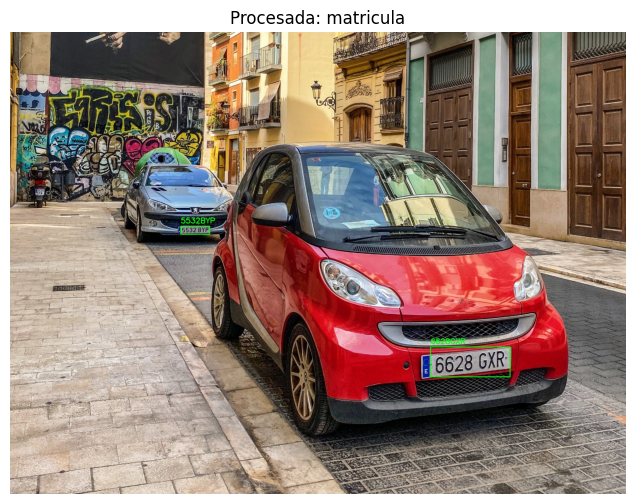

coche9 → ['MK3532']


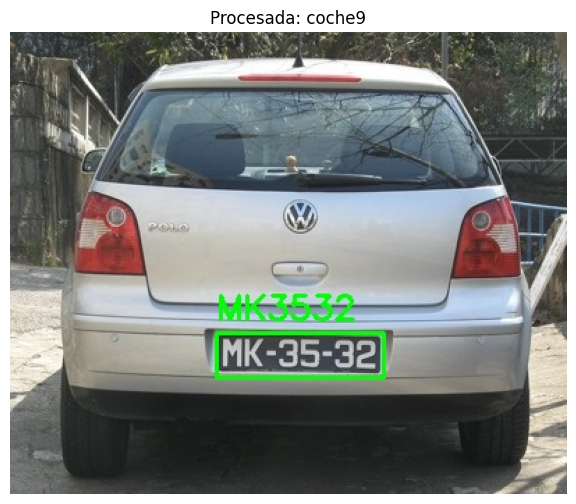

coche4 → Sin detección


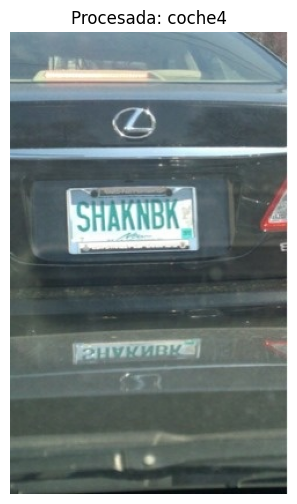

matricula5 → ['8787LBC']


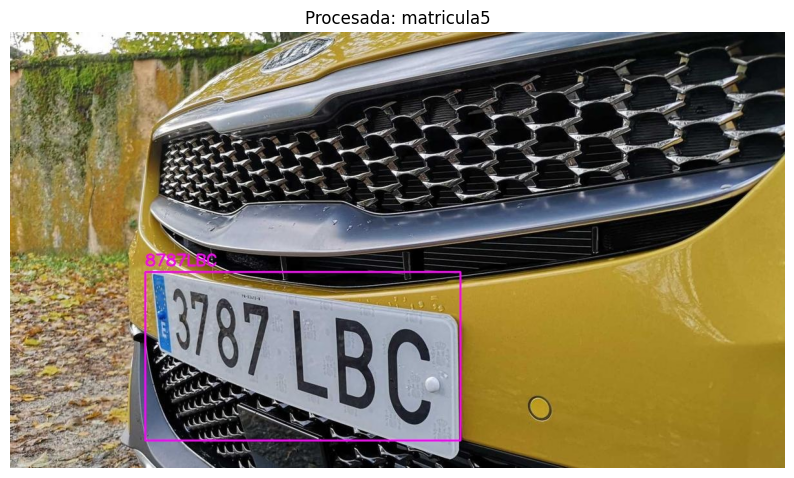

coche11 → ['MS66YOB']


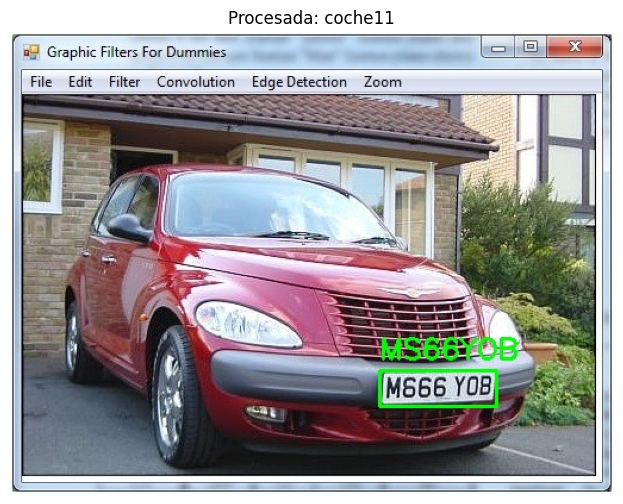

coche2 → ['HR26BC5514']


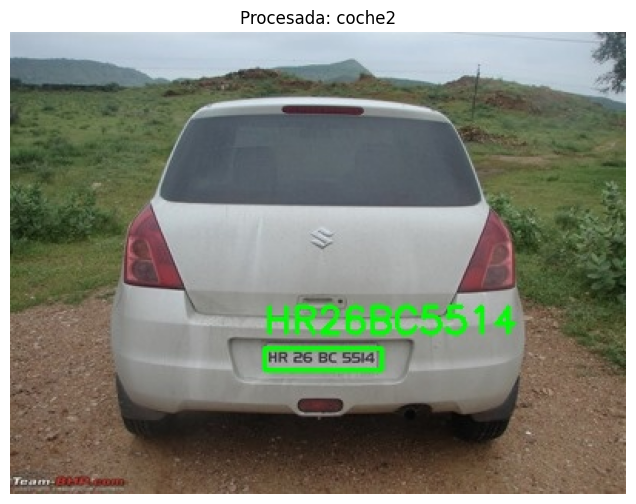

matricula3 → ['4046JBB', '1398HKL', 'SP1514']


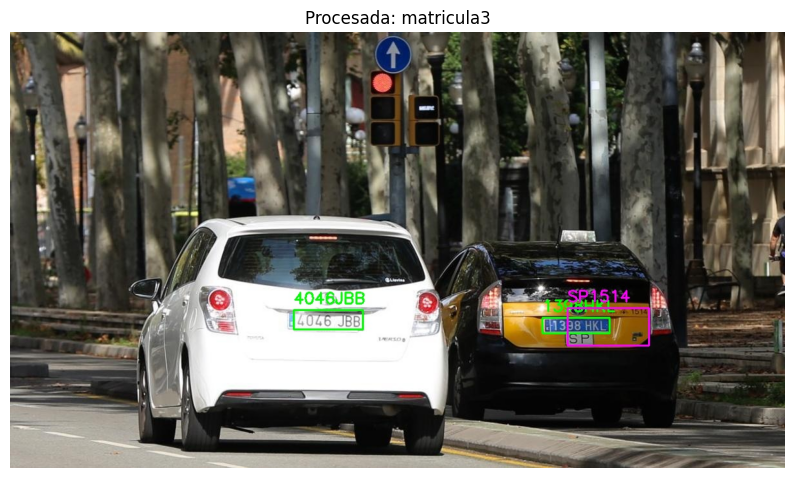

coche1 → Sin detección


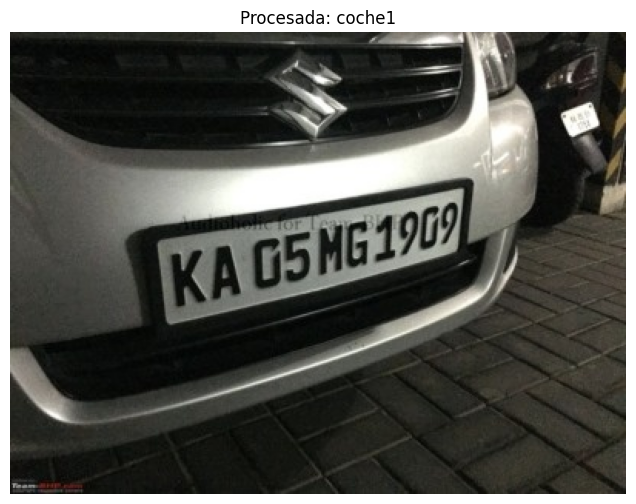

coche5 → Sin detección


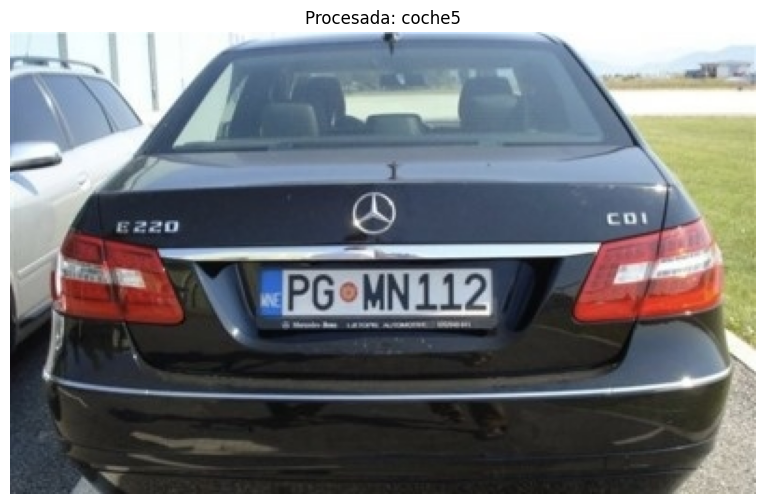

coche6 → Sin detección


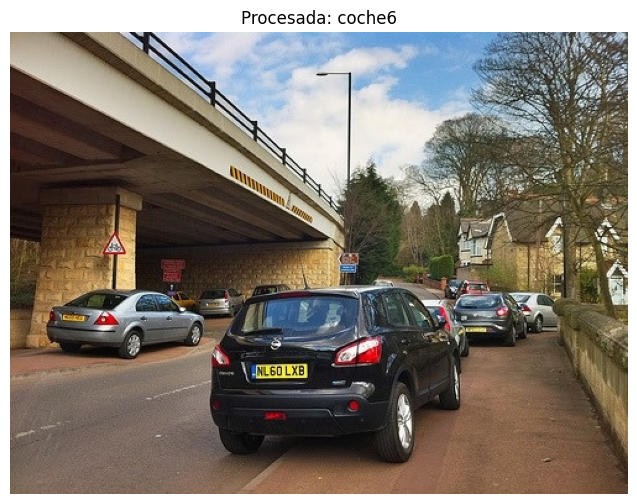

matricula6 → ['1135GSB']


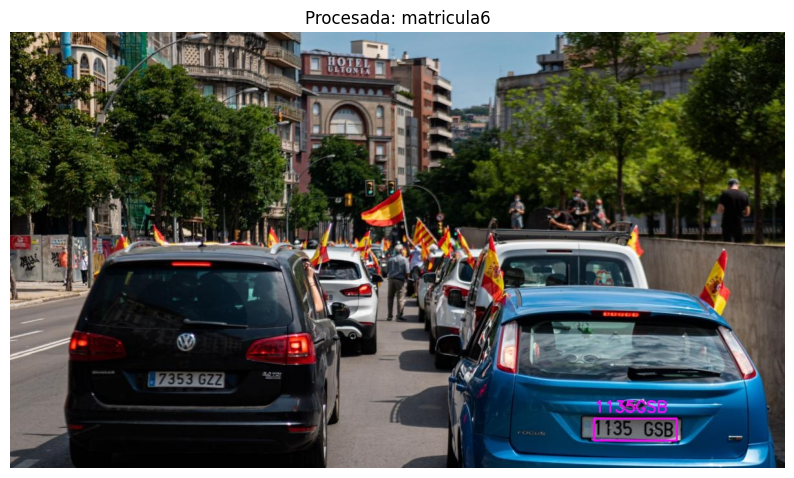

matricula2 → ['3800KCH', '8194JCX']


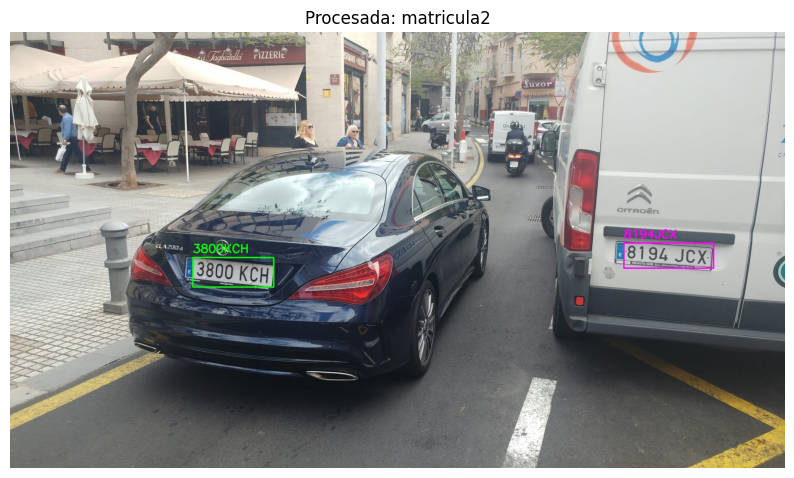

coche3 → ['KLG1CA2555']


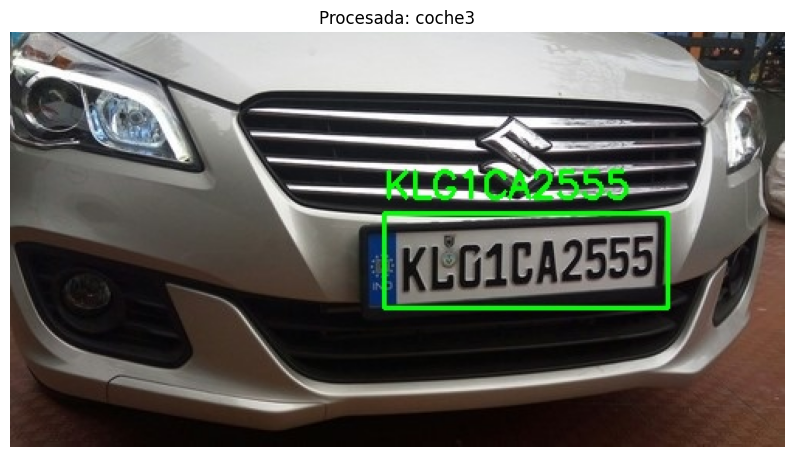

coche7 → ['JA62UAR']


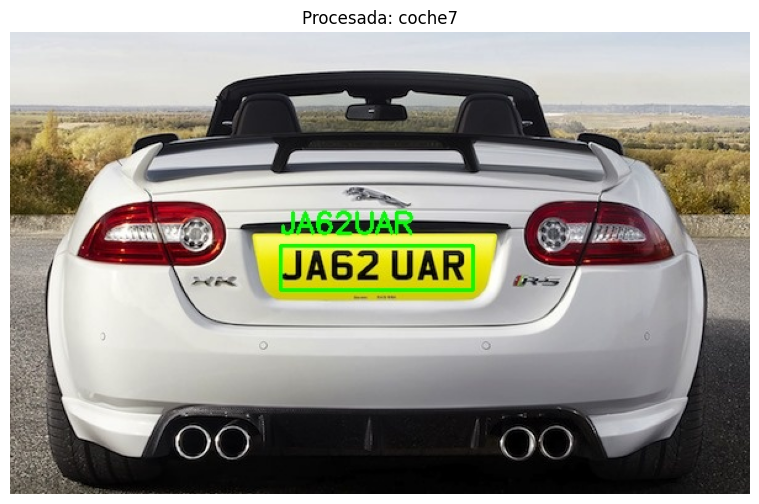

coche8 → ['MH20EE7598']


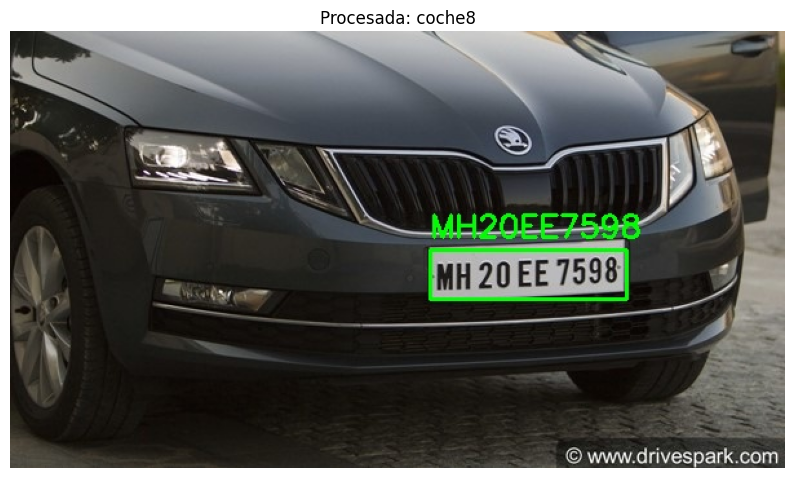

coche12 → ['HH12867237']


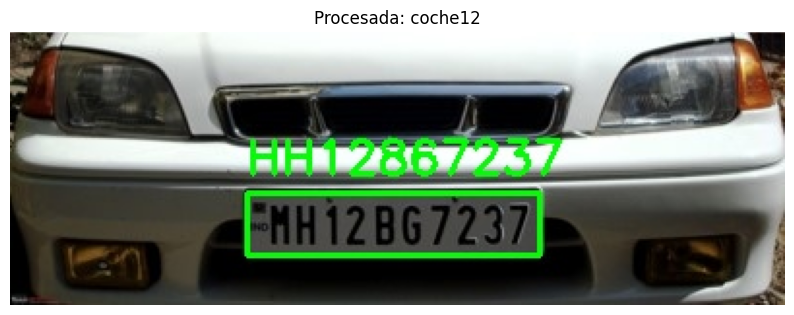

coche10 → Sin detección


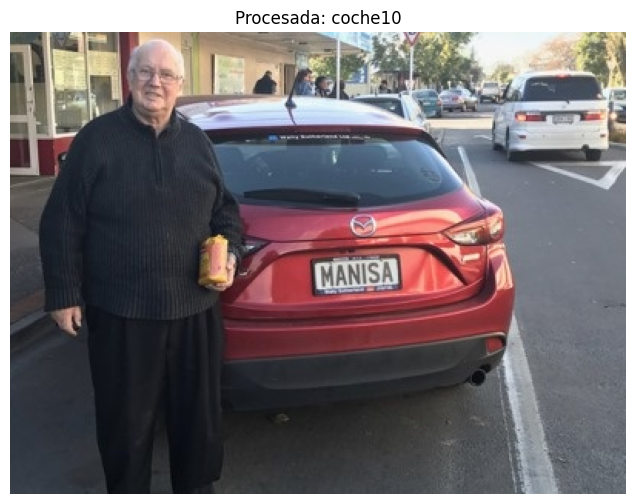

matricula4 → ['7011CDZ']


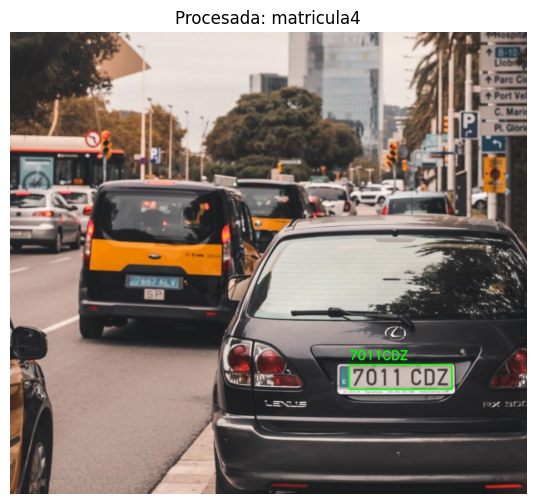

Proceso completo. Resultados guardados en: todas_matriculas.txt


In [ ]:
# Importamos las librerías necesarias:
import cv2                     # Procesamiento de imágenes
import easyocr                 # OCR para leer textos en imágenes
import matplotlib.pyplot as plt  # Visualización de imágenes
import re                      # Expresiones regulares para limpiar textos
import numpy as np             # Operaciones numéricas y con arrays
from pathlib import Path       # Manejo de rutas y archivos


# Definimos la carpeta que contiene las imágenes a procesar
carpeta_imagenes = '.'
# Definimos la carpeta en la que guardaremos las imágenes procesadas
salida_imagenes = 'matriculas_procesadas_pablo'
# Archivo de salida para guardar las matrículas detectadas
archivo_salida = 'todas_matriculas.txt'

# Crear la carpeta de salida si no existe
Path(salida_imagenes).mkdir(exist_ok=True)

# Creamos el lector de EasyOCR para el idioma español ('es')
lector = easyocr.Reader(['es'])

# FUNCIONES

def parece_matricula(texto):

    # Comprobamos la longitud del texto
    if not (5 <= len(texto) <= 10):
        return False
    # Contamos cuántos caracteres son letras y cuántos son dígitos
    letras = sum(c.isalpha() for c in texto)
    numeros = sum(c.isdigit() for c in texto)
    # Se acepta si tiene al menos 2 letras y 2 dígitos
    if letras >= 2 and numeros >= 2:
        return True
    # También se acepta si el texto está formado solo por letras y su longitud es entre 3 y 7
    if letras == len(texto) and 3 <= letras <= 7:
        return True
    return False

def procesar_imagen(ruta_imagen):

    # Se lee la imagen utilizando OpenCV
    imagen = cv2.imread(str(ruta_imagen))


    # Se convierte la imagen a escala de grises
    gris = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
    #Se mejora el contraste con ecualización del histograma (aunque en este caso no se utiliza en la detección)
    imagen_preprocesada = cv2.equalizeHist(gris)

    '''
    Las imagenes preprocesadas en escala de grises para mejorar el contraste no se utilizan
    ya que, a pesar de detectar alguna matrícula que de manera normal no detectamos, se deja otras por el camino o tiene otros
    errores de lectura de números y letras.
    '''

    # Se aplica OCR a la imagen (utilizamos la imagen original)
    resultados = lector.readtext(imagen)

    # Listas para almacenar diferentes tipos de detecciones
    matriculas_completas = []  # Detecciones que parecen una matrícula completa
    numeros = []               # Fragmentos detectados que son solo números
    letras = []                # Fragmentos detectados que son solo letras

    # Se recorre cada resultado obtenido del OCR
    for (bbox, texto_original, probabilidad) in resultados:
        # Se limpia el texto removiendo caracteres especiales y se convierte a mayúsculas
        texto_limpio = re.sub(r'[^A-Za-z0-9]', '', texto_original).upper()
        # Se descartan textos con baja probabilidad o sin contenido
        if probabilidad < 0.3 or len(texto_limpio) == 0:
            continue
        # Si el texto parece una matrícula completa, se guarda y se salta el resto del ciclo
        if parece_matricula(texto_limpio):
            matriculas_completas.append({'texto': texto_limpio, 'bbox': bbox})
            continue
        # Si el texto es numérico y tiene una longitud entre 3 y 5, se guarda en la lista de números
        if texto_limpio.isdigit() and 3 <= len(texto_limpio) <= 5:
            numeros.append({'texto': texto_limpio, 'bbox': bbox})
        # Si el texto es alfabético y tiene entre 2 y 4 caracteres, se guarda en la lista de letras
        elif texto_limpio.isalpha() and 2 <= len(texto_limpio) <= 4:
            letras.append({'texto': texto_limpio, 'bbox': bbox})



    # Dibujo de las matrículas completas detectadas (en verde)
    for entrada in matriculas_completas:
        texto = entrada['texto']
        bbox = entrada['bbox']
        # Extraemos las coordenadas de la esquina superior izquierda y la inferior derecha
        (tl, _, br, _) = bbox
        tl = tuple(map(int, tl))
        br = tuple(map(int, br))
        # Dibujamos un rectángulo alrededor del área detectada
        cv2.rectangle(imagen, tl, br, (0, 255, 0), 2)
        # Escribimos el texto de la matrícula sobre la imagen
        cv2.putText(imagen, texto, (tl[0], tl[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)



    # Combinamos fragmentos de números y letras para formar posibles matrículas
    fragmentos = numeros + letras
    # Ordenamos los fragmentos de izquierda a derecha según la menor coordenada X de su bbox
    fragmentos.sort(key=lambda x: np.min(np.array(x['bbox'])[:, 0]))

    # Lista para guardar las predicciones de matrículas
    matriculas_predichas = []
    usados = set()  # Se usa para evitar combinaciones duplicadas

    # Probamos combinaciones consecutivas de múltiples fragmentos
    for i in range(len(fragmentos)):
        for j in range(i+1, min(i+4, len(fragmentos)+1)):
            # Se concatenan los textos de los fragmentos en la posición i hasta j
            combinacion = ''.join(f['texto'] for f in fragmentos[i:j])
            # Si esta combinación ya se usó, se salta
            if combinacion in usados:
                continue
            # Se comprueba si la combinación cumple con el formato de matrícula
            if parece_matricula(combinacion):
                usados.add(combinacion)
                # Se recogen las coordenadas de cada fragmento de la combinación
                bboxes = [f['bbox'] for f in fragmentos[i:j]]
                matriculas_predichas.append({'texto': combinacion, 'bboxes': bboxes})

    # Dibujamos las combinaciones detectadas (en púrpura)
    for entrada in matriculas_predichas:
        texto = entrada['texto']
        bboxes = entrada['bboxes']
        # Se une toda las coordenadas de los fragmentos para determinar la caja que contiene la combinación
        coords = np.concatenate(bboxes)
        x_min, y_min = coords.min(axis=0).astype(int)
        x_max, y_max = coords.max(axis=0).astype(int)
        # Dibuja el rectángulo con la combinación detectada
        cv2.rectangle(imagen, (x_min, y_min), (x_max, y_max), (255, 0, 255), 2)
        cv2.putText(imagen, texto, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 255), 2)

    # Guardamos la imagen con las detecciones dibujadas.
    nombre_archivo = Path(ruta_imagen).stem
    cv2.imwrite(f"{salida_imagenes}/{nombre_archivo}_procesada.jpg", imagen)

    # Creamos una lista final de matrículas detectadas quitando duplicados
    todas = list(set(
        [m['texto'] for m in matriculas_completas] +
        [m['texto'] for m in matriculas_predichas]
    ))
    return nombre_archivo, todas


# Extensiones válidas
extensiones_validas = ['.jpg', '.jpeg', '.png', '.bmp']
# Ruta de la carpeta con las imágenes
ruta_carpeta = Path(carpeta_imagenes)
resultados_totales = []


print(ruta_carpeta)
# Se itera sobre cada archivo de imagen en la carpeta
for ruta_imagen in ruta_carpeta.iterdir():
    if ruta_imagen.suffix.lower() in extensiones_validas:
        nombre, placas = procesar_imagen(ruta_imagen)

        for placa in placas:
            resultados_totales.append(f"{nombre}: {placa}")
        print(f"{nombre} → {placas if placas else 'Sin detección'}")

        # Ruta de la imagen procesada
        ruta_procesada = Path(salida_imagenes) / f"{nombre}_procesada.jpg"

        # Leer y mostrar la imagen procesada con matplotlib
        imagen_procesada = cv2.imread(str(ruta_procesada))
        imagen_procesada = cv2.cvtColor(imagen_procesada, cv2.COLOR_BGR2RGB)  # OpenCV usa BGR
        plt.figure(figsize=(10, 6))
        plt.imshow(imagen_procesada)
        plt.title(f"Procesada: {nombre}")
        plt.axis('off')
        plt.show()



# Archivo de texto con todas las matrículas detectadas
with open(archivo_salida, 'w') as f:
    for linea in resultados_totales:
        f.write(linea + "\n")
print("Proceso completo. Resultados guardados en:", archivo_salida)

La primera función importante se encarga de comprobar si los fragmentos detectados se parecen a una matrícula siguiendo una serie de condiciones o patrones en base a la variedad de formatos de matrícula que hay en el mundo:

    - Matrículas que combinen letras y números, contando con un mínimo de 2 de cada una y con una longitud máxima combinada de 10 caracteres.
    
    - Matrículas que contienen únicamente letras, con una extensión entre 3 y 7 caracteres.

Después de esta función, está definida la encargada de procesar las imágenes.
Esta extrae los bloques de texto junto con su caja delimitadora y un nivel de probabilidad de confianza respecto a los caracteres obtenidos.
Además, se limpia el texto ante posibles errores en los que se detecten caracteres especiales como paréntesis o guiones que alteran los resultados y baja el porcentaje de acierto. Por otra parte, descartamos los bloques con probabilidad muy baja (inferiores a 0.3 sobre 1) o vacíos de contenido. Por último, se separan matrículas completas de fragmentos.

Para las detecciones de matrículas completas, dibujamos un rectángulo verde y añadimos el texto detectado.
Para aquellos fragmentos que forman parte de una posible predicción, se combinan ordenados de izquierda a derecha si cumplen alguno de los criterios y se dibujan el rectángulo y el texto de color púrpura para diferenciar.

Una vez terminado el proceso, guardamos la imagen resultante en la carpeta de salida y se crea una lista con las matrículas y la almacenamos en un archivo de texto. También imprimimos los resultados de texto detectados por consola para cada imagen.

In [ ]:
!pip install easyocr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 17.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 40.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 29.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 95.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.8/422.8 kB 30.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Redes convolucionales**

# **Instalación de librerias**

Se instalan las librerias: `kaggle`, para descargar el dataset; `ultrelytics`, para usar YOLOv8, y `easyocr`, para el reconocimiento de texto.

In [ ]:
# Instalamos las librerías necesarias:
# - kagglehub: para descargar datasets de Kaggle de forma sencilla
# - ultralytics: para usar YOLOv8
# - easyocr: para leer texto (OCR) desde las matrículas detectadas
!pip install -q kaggle
!pip install -q ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 36.9 MB/s eta 0:00:00


# **Autenticación en Kaggle**

Para poder acceder a la base de datos de Kaggle es necesario subir el archivo `kaggle.json` con las credenciales necesarias.

In [ ]:
# Abre un diálogo para subir tu archivo kaggle.json
# Este archivo permite autenticar tu cuenta de Kaggle y descargar datasets
from google.colab import files
uploaded = files.upload()



Saving kaggle.json to kaggle (1).json


# **Configuración del entorno**

Se genera la estructura de carpetas para que Kaggle funcione correctamente.

In [ ]:
import os

# Creamos el directorio oculto donde se guarda la API de Kaggle
os.makedirs("/root/.kaggle", exist_ok=True)

# Movemos el archivo kaggle.json a la ubicación esperada
os.rename("kaggle.json", "/root/.kaggle/kaggle.json")

# Le damos permisos seguros al archivo
os.chmod("/root/.kaggle/kaggle.json", 0o600)


# **Descarga de la base de datos**

In [ ]:
# Descarga el dataset ZIP desde Kaggle usando el CLI
!kaggle datasets download -d andrewmvd/car-plate-detection

Dataset URL: https://www.kaggle.com/datasets/andrewmvd/car-plate-detection
License(s): CC0-1.0
 89% 180M/203M [00:00<00:00, 358MB/s]
100% 203M/203M [00:00<00:00, 368MB/s]


# **Extracción del dataset**

In [ ]:
# Extraemos el contenido del ZIP en una carpeta
!unzip -q car-plate-detection.zip -d car-plate-detection

# **Conversión de las etiquetas a formato YOLO**

En la base de datos que estamos las etiquetas, donde están delimitadas las bounding boxes de las matriculas, de las imagenes son archivos `.xml`. Así que es necesario generar, a partir de estos los archivos `.txt` que requiere YOLO.

In [ ]:
import os
import xml.etree.ElementTree as ET

def convert_coordinates(size, box):
    dw = 1.0 / size[0]
    dh = 1.0 / size[1]
    x = (box[0] + box[1]) / 2.0 * dw
    y = (box[2] + box[3]) / 2.0 * dh
    w = (box[1] - box[0]) * dw
    h = (box[3] - box[2]) * dh
    return (x, y, w, h)

def convert_xml2yolo(xml_folder, output_folder):
    os.makedirs(output_folder, exist_ok=True)
    empty_count = 0
    valid_count = 0

    for xml_file in os.listdir(xml_folder):
        if not xml_file.endswith(".xml"):
            continue

        tree = ET.parse(os.path.join(xml_folder, xml_file))
        root = tree.getroot()

        size = root.find("size")
        if size is None:
            continue

        width = int(size.find("width").text)
        height = int(size.find("height").text)

        image_id = os.path.splitext(xml_file)[0]
        output_path = os.path.join(output_folder, f"{image_id}.txt")

        lines = []
        for obj in root.iter("object"):
            cls = obj.find("name").text
            if cls.lower() != "licence": #Se ignoran los objetos que no son matriculas
                continue

            xmlbox = obj.find("bndbox")
            if xmlbox is None:
                continue

            try:
                b = (
                    int(xmlbox.find("xmin").text),
                    int(xmlbox.find("xmax").text),
                    int(xmlbox.find("ymin").text),
                    int(xmlbox.find("ymax").text),
                )
                bb = convert_coordinates((width, height), b)
                lines.append(f"0 {bb[0]} {bb[1]} {bb[2]} {bb[3]}")
            except:
                continue

        if lines:
            valid_count += 1
            with open(output_path, "w") as f:
                f.write("\n".join(lines))
        else:
            empty_count += 1

    print(f"✅ Conversión completa.")
    print(f"Archivos con etiquetas: {valid_count}")
    print(f"Archivos vacíos: {empty_count}")

# Ejecutar conversión
convert_xml2yolo("/content/car-plate-detection/annotations", "/content/labels")


✅ Conversión completa.
Archivos con etiquetas: 433
Archivos vacíos: 0


# **Divisió del dataset en entrenamiento y validación**

---



Se crea la estructura de carpetas ,`/dataset/images/train` y `/dataset/images/val`, que require YOLO.

Se usa un 80% de los datos para en entrenamiento y un 20% para la validación.

In [ ]:
import os
import shutil
from sklearn.model_selection import train_test_split

img_dir = "/content/car-plate-detection/images"
label_dir = "/content/labels"
img_ext = ".png"

# Crear estructura YOLO
for split in ["train", "val"]:
    os.makedirs(f"/content/dataset/images/{split}", exist_ok=True)
    os.makedirs(f"/content/dataset/labels/{split}", exist_ok=True)

# Solo archivos válidos (con anotaciones)
valid_files = []
for label_file in os.listdir(label_dir):
    label_path = os.path.join(label_dir, label_file)
    if label_file.endswith(".txt") and os.path.getsize(label_path) > 0:
        name = label_file.replace(".txt", "")
        if os.path.exists(os.path.join(img_dir, f"{name}{img_ext}")):
            valid_files.append(name)

# Dividir train/val
train_files, val_files = train_test_split(valid_files, test_size=0.2, random_state=42)

# Copiar solo imágenes y etiquetas con contenido
def move_files(file_list, split):
    for f in file_list:
        shutil.copy(f"{img_dir}/{f}{img_ext}", f"/content/dataset/images/{split}/{f}{img_ext}")
        shutil.copy(f"{label_dir}/{f}.txt", f"/content/dataset/labels/{split}/{f}.txt")

move_files(train_files, "train")
move_files(val_files, "val")

print(f"Total válidos con cajas: {len(valid_files)}")
print(f"Train: {len(train_files)}")
print(f"Val: {len(val_files)}")


Total válidos con cajas: 433
Train: 346
Val: 87


# **Entrenamiento de la CNN**

**Funciones para el calculo de métricas**

In [ ]:
# === Función para calcular IoU ===
def calcular_iou(box1, box2):
    # Ambos en formato (x1, y1, x2, y2)
    xi1 = max(box1[0], box2[0])
    yi1 = max(box1[1], box2[1])
    xi2 = min(box1[2], box2[2])
    yi2 = min(box1[3], box2[3])

    inter_area = max(0, xi2 - xi1) * max(0, yi2 - yi1)
    box1_area = max(0, box1[2] - box1[0]) * max(0, box1[3] - box1[1])
    box2_area = max(0, box2[2] - box2[0]) * max(0, box2[3] - box2[1])
    union_area = box1_area + box2_area - inter_area

    if union_area == 0:
        return 0
    else:
        return inter_area / union_area

# === Evaluar CNN: Precision, Recall e IoU medio ===
def evaluar_cnn(model, dataloader, iou_threshold=0.5):
    model.eval()
    TP, FP, FN = 0, 0, 0
    ious = []

    with torch.no_grad():
        for x, y_true in dataloader:
            x, y_true = x.to(device), y_true.to(device)
            y_pred = model(x)

            for pred, true in zip(y_pred, y_true):
                # Normalizados a píxeles
                xc_p, yc_p, w_p, h_p = pred.cpu().numpy()
                xc_t, yc_t, w_t, h_t = true.cpu().numpy()

                def to_xyxy(xc, yc, w, h, img_w=256, img_h=128):
                    x1 = (xc - w/2) * img_w
                    y1 = (yc - h/2) * img_h
                    x2 = (xc + w/2) * img_w
                    y2 = (yc + h/2) * img_h
                    return [x1, y1, x2, y2]

                box_p = to_xyxy(xc_p, yc_p, w_p, h_p)
                box_t = to_xyxy(xc_t, yc_t, w_t, h_t)

                iou = calcular_iou(box_p, box_t)
                ious.append(iou)

                if iou >= iou_threshold:
                    TP += 1
                else:
                    FP += 1
                    FN += 1

    precision = TP / (TP + FP + 1e-6)
    recall = TP / (TP + FN + 1e-6)
    iou_mean = sum(ious) / len(ious)

    print(f"→ Precisión: {precision:.4f}")
    print(f"→ Recall:    {recall:.4f}")
    print(f"→ IoU medio: {iou_mean:.4f}")


**Definicin y entrenamiento de la CNN**

In [ ]:
# Importación de bibliotecas necesarias
import os  # Para manipular rutas de archivos
from PIL import Image  # Para abrir imágenes
import torch  # PyTorch para deep learning
import torch.nn as nn  # Módulos de redes neuronales
import torch.nn.functional as F  # Funciones como ReLU
from torch.utils.data import Dataset, DataLoader, random_split  # Utilidades para datasets
from torchvision import transforms  # Transformaciones de imágenes
import matplotlib.pyplot as plt  # Para graficar imágenes y resultados

# Clase personalizada del dataset para detección de la caja de matrícula
class CarPlateBoundingBoxDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        # Directorios donde se encuentran las imágenes y las etiquetas
        self.image_dir = os.path.join(root_dir, "images", "train")
        self.label_dir = os.path.join(root_dir, "labels", "train")
        self.transform = transform
        self.samples = []  # Lista para almacenar (imagen, bbox)

        # Itera sobre todos los archivos de imagen en el directorio
        for img_file in os.listdir(self.image_dir):
            if img_file.endswith(".png"):  # Solo archivos PNG
                img_path = os.path.join(self.image_dir, img_file)
                label_path = os.path.join(self.label_dir, img_file.replace(".png", ".txt"))

                if os.path.exists(label_path):  # Verifica que exista el archivo de etiqueta
                    with open(label_path, "r") as f:
                        line = f.readline()
                        parts = line.strip().split()
                        if len(parts) == 5:  # Formato YOLO: clase xc yc w h
                            bbox = list(map(float, parts[1:]))  # Solo toma coordenadas
                            if len(bbox) == 4:
                                self.samples.append((img_path, bbox))  # Añade muestra válida

    def __len__(self):
        return len(self.samples)  # Cantidad de muestras

    def __getitem__(self, idx):
        img_path, bbox = self.samples[idx]
        image = Image.open(img_path).convert("L")  # Abre imagen en escala de grises
        if self.transform:
            image = self.transform(image)  # Aplica transformaciones si existen
        bbox = torch.tensor(bbox, dtype=torch.float32)  # Convierte el bbox a tensor
        return image, bbox
# Transformaciones para las imágenes (redimensionar + tensor)
transform = transforms.Compose([
    transforms.Resize((128, 256)),  # Aumenta resolución
    transforms.ToTensor(),  # Convierte imagen a tensor
])

# Definición de la red neuronal convolucional para predecir bounding boxes
class PlateBBoxCNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(1, 16, 3, padding=1)  # 1 canal de entrada, 16 filtros
        self.conv2 = nn.Conv2d(16, 32, 3, padding=1)  # 32 filtros
        self.pool = nn.MaxPool2d(2, 2)  # Reduce tamaño a la mitad
        self.fc1 = nn.Linear(32 * 32 * 64, 128)  # Capa totalmente conectada
        self.fc2 = nn.Linear(128, 4)  # Salida: xc, yc, w, h (4 valores)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))  # Conv1 + ReLU + MaxPooling
        x = self.pool(F.relu(self.conv2(x)))  # Conv2 + ReLU + MaxPooling
        x = x.view(x.size(0), -1)  # Flatten para pasar a capa densa
        x = F.relu(self.fc1(x))  # Activación en capa densa
        return torch.sigmoid(self.fc2(x))  # Salida normalizada entre 0 y 1

# Carga del dataset
root_dir = "/content/dataset"
dataset = CarPlateBoundingBoxDataset(root_dir, transform=transform)

# División en entrenamiento y test (80/20)
train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size
train_ds, test_ds = random_split(dataset, [train_size, test_size])

# Dataloaders para entrenamiento y prueba
train_loader = DataLoader(train_ds, batch_size=16, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=16)

# Configuración del modelo y entrenamiento
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Usa GPU si hay
model = PlateBBoxCNN().to(device)  # Pasa el modelo al dispositivo
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)  # Optimizador Adam
criterion = nn.MSELoss()  # Error cuadrático medio (MSE) para regresión



In [ ]:
# Ciclo de entrenamiento
for epoch in range(200):
    model.train()  # Modo entrenamiento
    total_loss = 0
    for x, y in train_loader:
        x, y = x.to(device), y.to(device)  # Enviar datos al dispositivo
        assert y.shape[1] == 4, f"Shape inesperada de y: {y.shape}"  # Verifica formato bbox
        optimizer.zero_grad()  # Reset gradientes
        output = model(x)  # Predicción
        loss = criterion(output, y)  # Cálculo del error
        loss.backward()  # Retropropagación
        optimizer.step()  # Actualización de pesos
        total_loss += loss.item()  # Acumula pérdida

    print(f"Epoch {epoch+1}, Loss: {total_loss / len(train_loader):.4f} \n")  # Log
    evaluar_cnn(model, test_loader)



# ✅ GUARDAR el modelo entrenado (state_dict)
torch.save({
    'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
}, 'modelo_cnn_200.pth')
print("Modelo guardado como 'modelo_cnn_200.pth'")

# **Creació del archivo de configuración para YOLO**

En este archivo se definen la ruta de las imagenes, el número de clases que hay que detectar y el nombre de la clase.

In [ ]:
yaml = """
path: /content/dataset
train: images/train
val: images/val
nc: 1
names: ['plate']
"""

with open("placa.yaml", "w") as f:
    f.write(yaml.strip())


# **Entrenamiento del modelo YOLO**

In [ ]:
!yolo detect train data=placa.yaml model=yolov8n.pt epochs=200 imgsz=640 plots=True


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 6.25M/6.25M [00:00<00:00, 111MB/s]
Ultralytics 8.3.149 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=placa.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7,

# **Visualización de resultados**

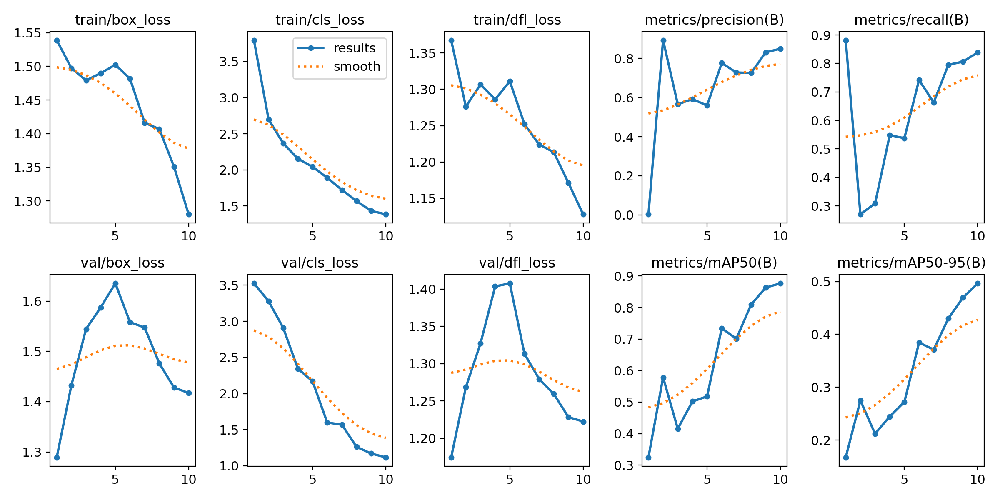

In [ ]:
from IPython.display import Image as IPyImage
IPyImage(filename='/content/runs/detect/train/results.png', width=800)


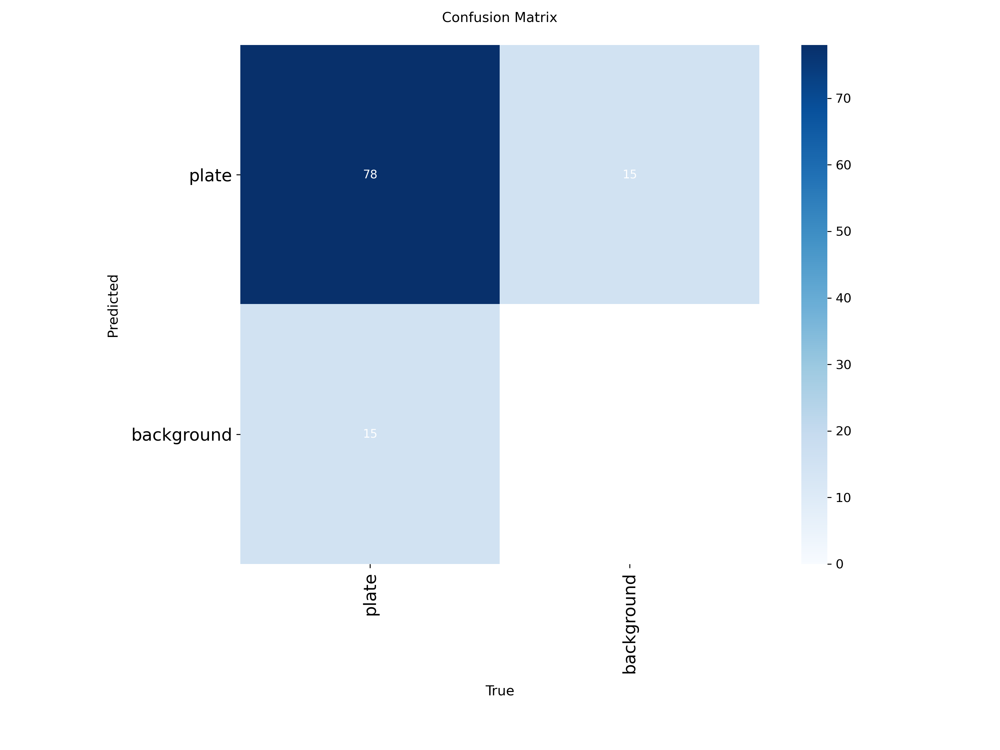

In [ ]:
IPyImage(filename='/content/runs/detect/train/confusion_matrix.png', width=600)

# **Inferencia con los modelos entrenados**

In [ ]:
'''from google.colab import drive
drive.mount('/content/drive')'''

Modelo cargado desde la epoch 200


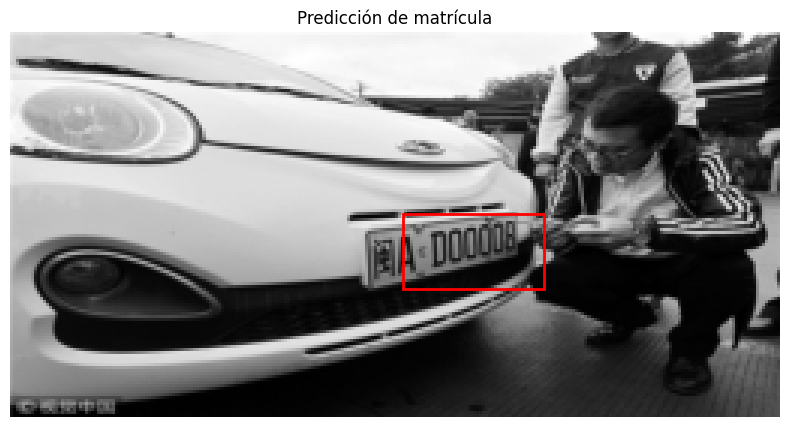

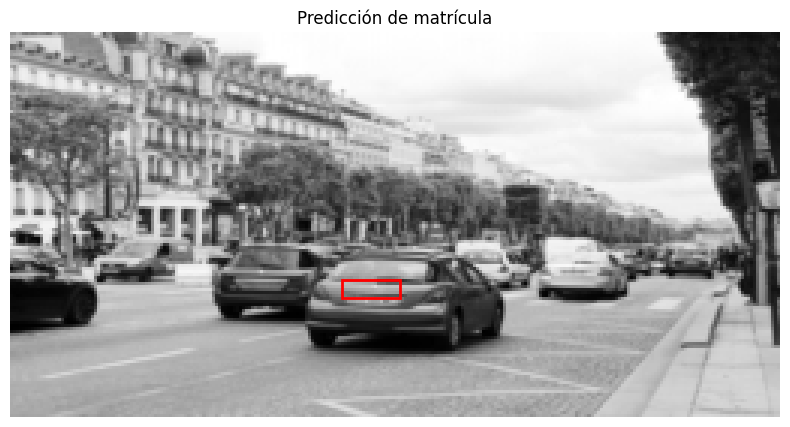

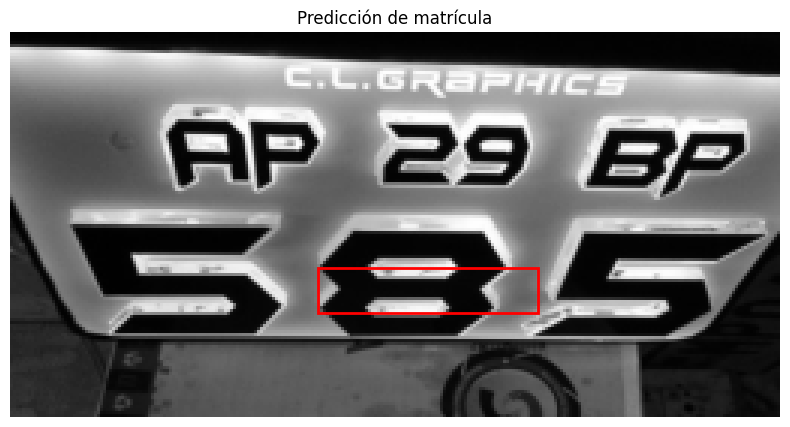

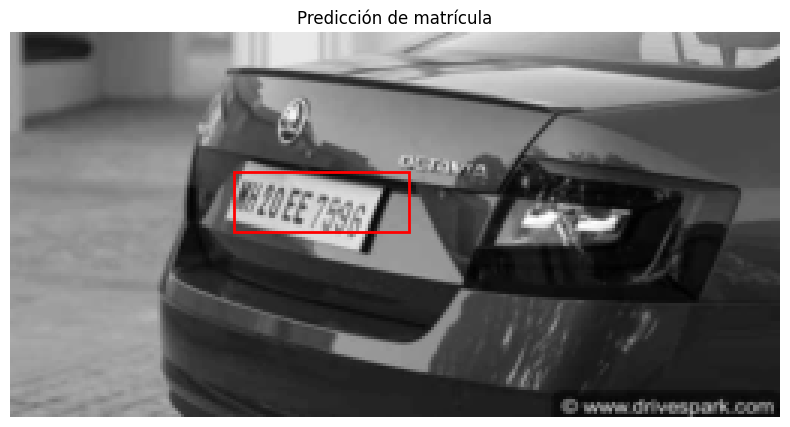

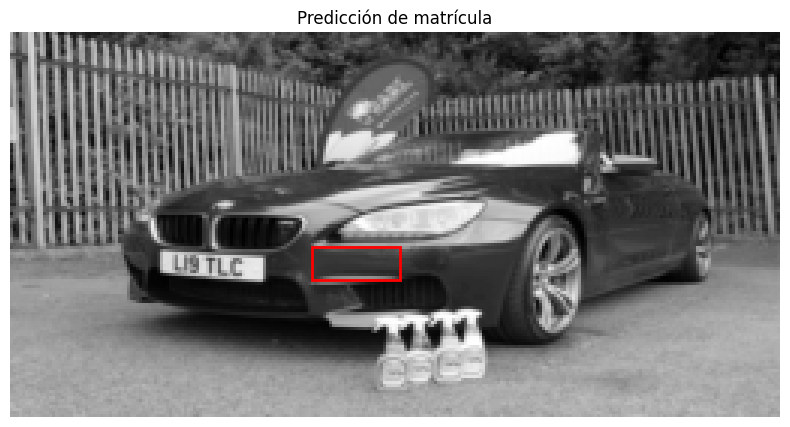

...

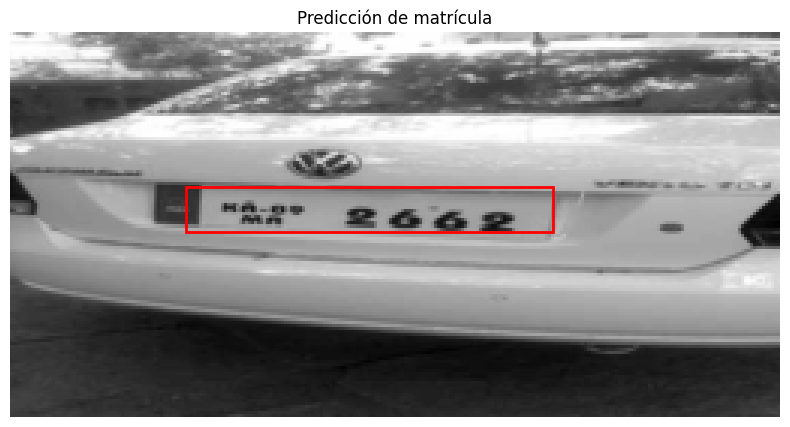

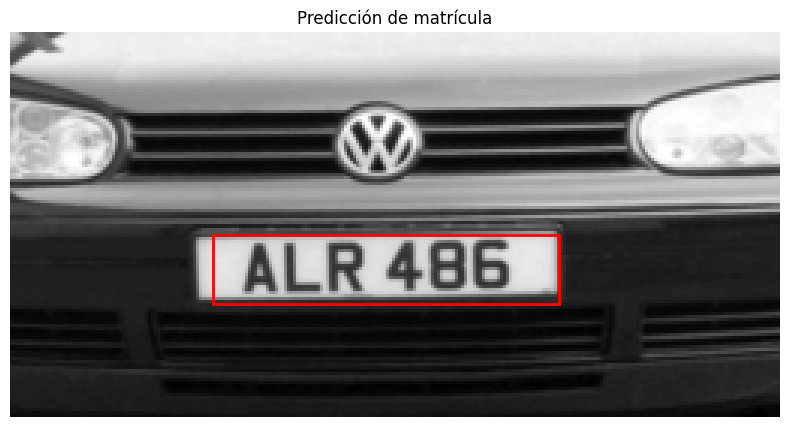

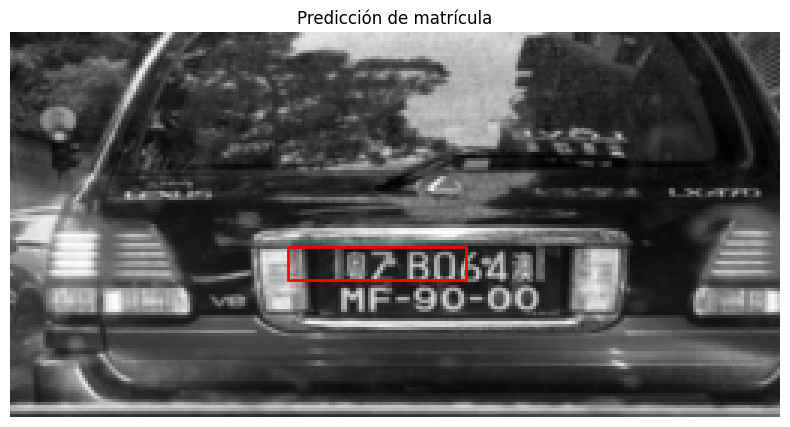

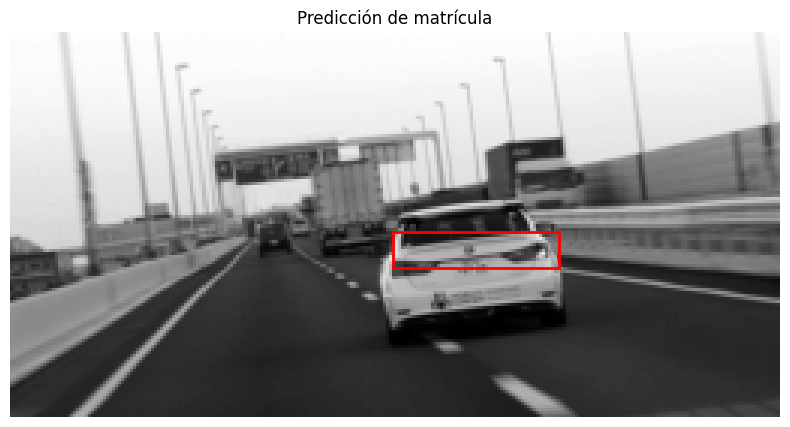

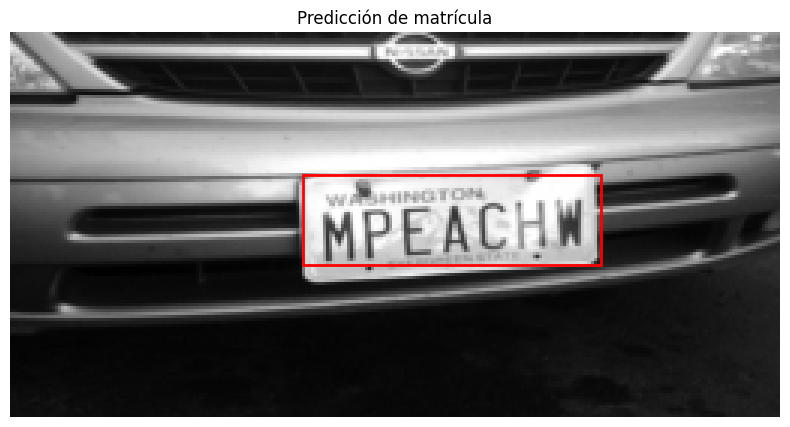

In [ ]:
# Crear el modelo y optimizador igual que antes
model = PlateBBoxCNN().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Cargar el checkpoint
checkpoint = torch.load('Modelo_cnn_200.pth', map_location=device)
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
start_epoch = checkpoint['epoch'] + 1

#model.eval()  # Si solo vas a usarlo para inferencia
print(f"Modelo cargado desde la epoch {start_epoch}")

# Función para visualizar predicciones
def visualizar_bbox_pred(model, dataloader):
    model.eval()  # Modo evaluación
    with torch.no_grad():  # No se calculan gradientes
        for x, y in dataloader:
            x = x.to(device)
            preds = model(x).cpu().numpy()  # Predicciones
            images = x.cpu().numpy()  # Imágenes en numpy

            for i in range(len(images)):
                img = images[i][0]  # Imagen en escala de grises
                pred_box = preds[i]  # Bounding box predicho
                h, w = img.shape  # Alto y ancho original

                # Convertir coordenadas normalizadas a píxeles
                xc, yc, bw, bh = pred_box
                x1 = int((xc - bw / 2) * w)
                y1 = int((yc - bh / 2) * h)
                x2 = int((xc + bw / 2) * w)
                y2 = int((yc + bh / 2) * h)

                # Mostrar imagen con bbox predicha
                plt.figure(figsize=(10, 5))
                plt.imshow(img, cmap='gray', interpolation='nearest')
                plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                                  edgecolor='red', facecolor='none', linewidth=2))
                plt.title("Predicción de matrícula")
                plt.axis('off')
                plt.show()
            break  # Solo muestra una tanda

# Mostrar visualización de predicciones en el set de prueba
visualizar_bbox_pred(model, test_loader)


In [ ]:
!yolo detect predict model=/content/best_200.pt source=/content/dataset/images/val


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

image 1/87 /content/dataset/images/val/Cars0.png: 352x640 1 plate, 45.0ms
image 2/87 /content/dataset/images/val/Cars1.png: 416x640 1 plate, 35.6ms
image 3/87 /content/dataset/images/val/Cars101.png: 480x640 1 plate, 35.6ms
image 4/87 /content/dataset/images/val/Cars102.png: 512x640 1 plate, 35.3ms
image 5/87 /content/dataset/images/val/Cars105.png: 384x640 2 plates, 35.0ms
image 6/87 /content/dataset/images/val/Cars117.png: 320x640 1 plate, 36.4ms
image 7/87 /content/dataset/images/val/Cars121.png: 480x640 1 plate, 6.7

# **Lectura y visualización de las matriculas con EasyOCR**

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete
Procesando imagen: Cars0.jpg


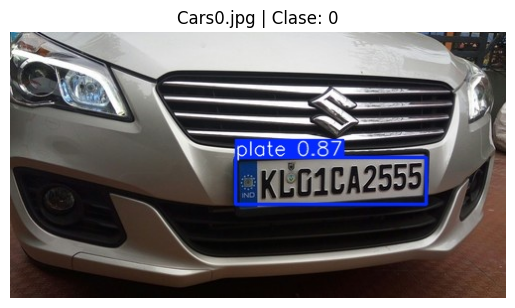

Texto detectado: KLO1CA2555

Procesando imagen: Cars1.jpg


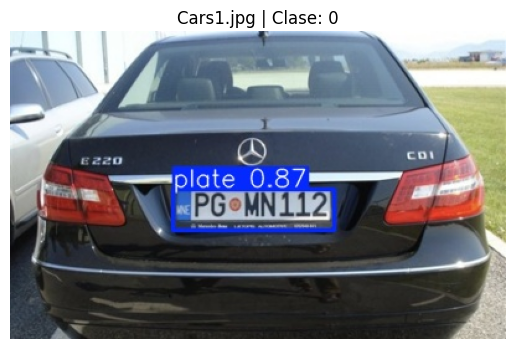

Texto detectado: PGoHN112

Procesando imagen: Cars101.jpg


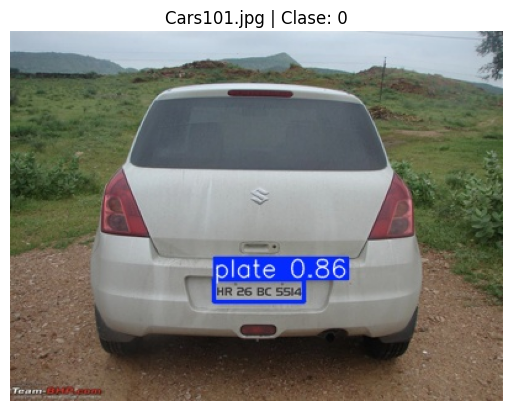

Texto detectado: HR26 BC 5514

Procesando imagen: Cars102.jpg


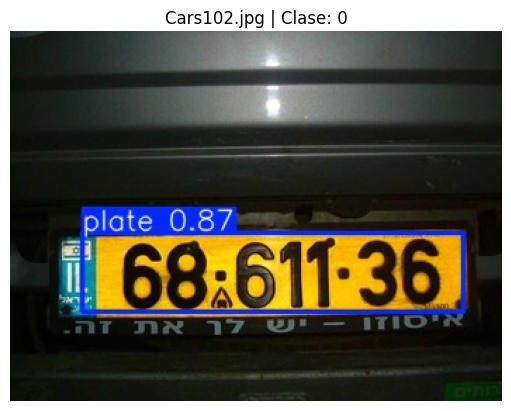

Texto detectado: 68.611*36

Procesando imagen: Cars105.jpg


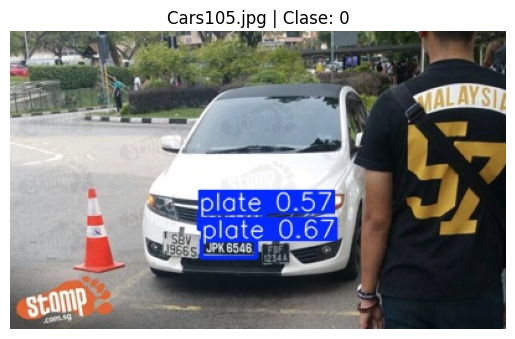


Procesando imagen: Cars117.jpg


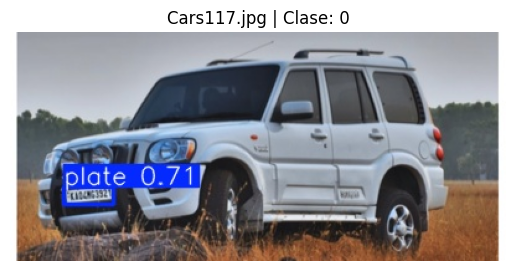


Procesando imagen: Cars121.jpg


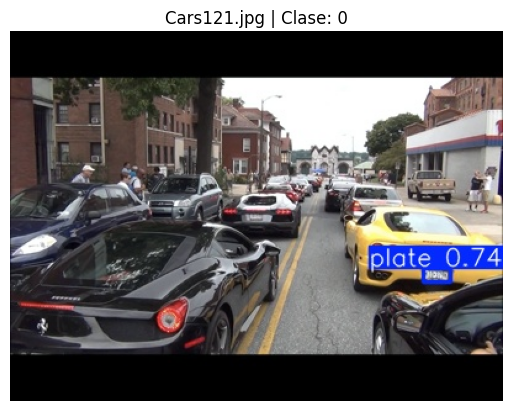


Procesando imagen: Cars131.jpg


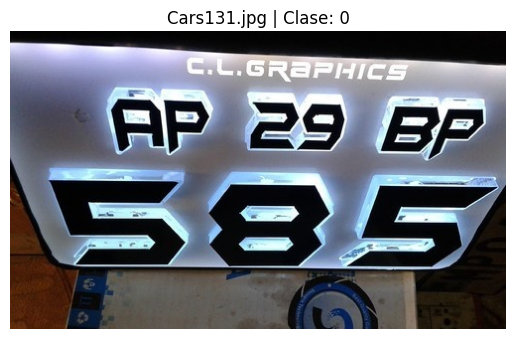

Texto detectado: @cGraPHICS
Texto detectado: AP
Texto detectado: 39
Texto detectado: BP
Texto detectado: 585

Procesando imagen: Cars140.jpg


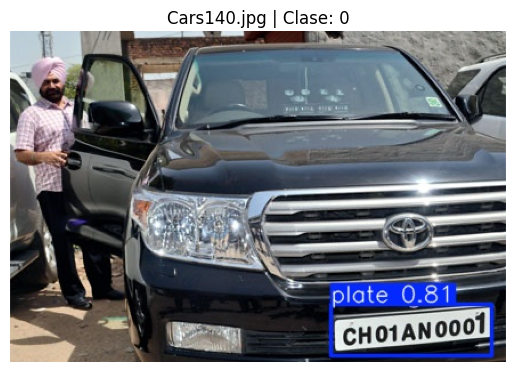

Texto detectado: CHOIANODo1

Procesando imagen: Cars146.jpg


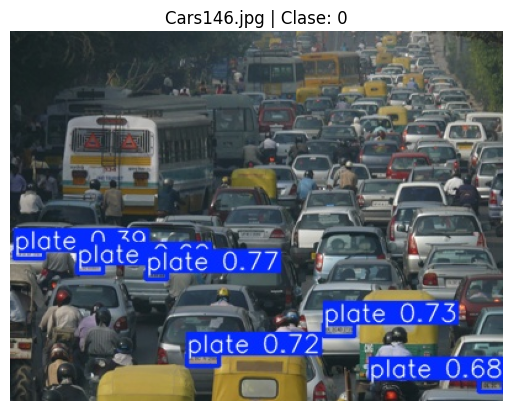

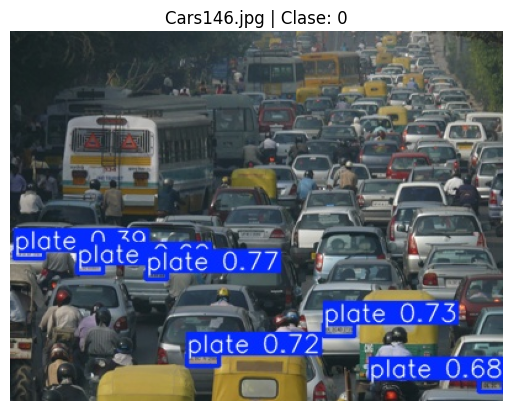

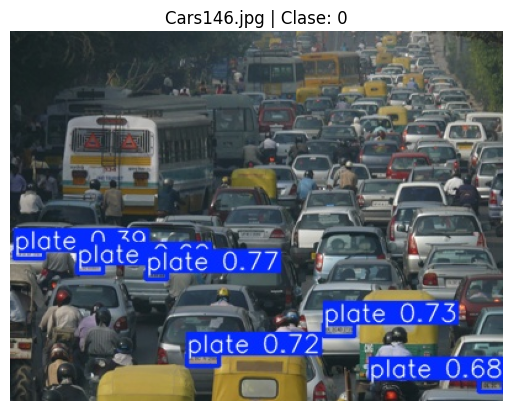

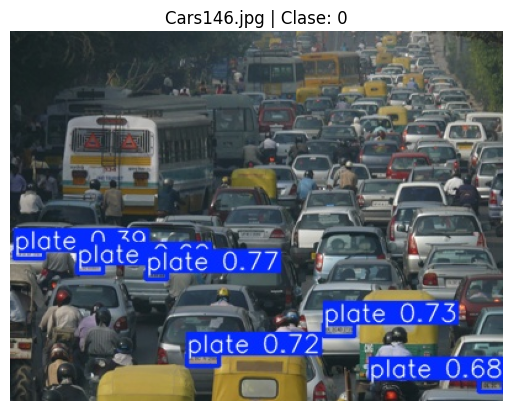


Procesando imagen: Cars15.jpg


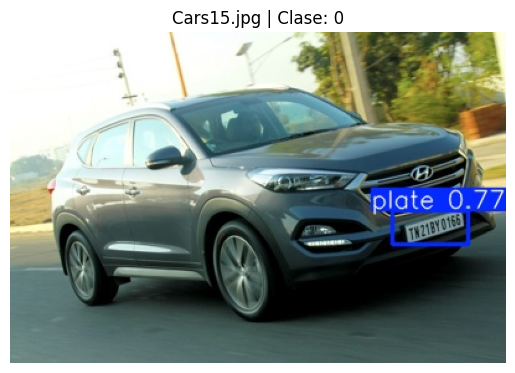

Texto detectado: W

Procesando imagen: Cars154.jpg


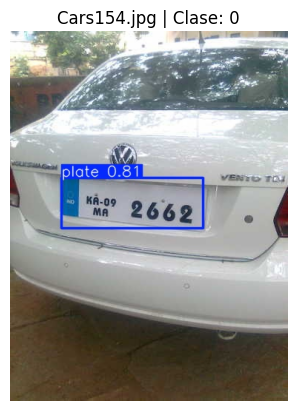

Texto detectado: Ka-09
Texto detectado: Ma
Texto detectado: 2662

Procesando imagen: Cars158.jpg


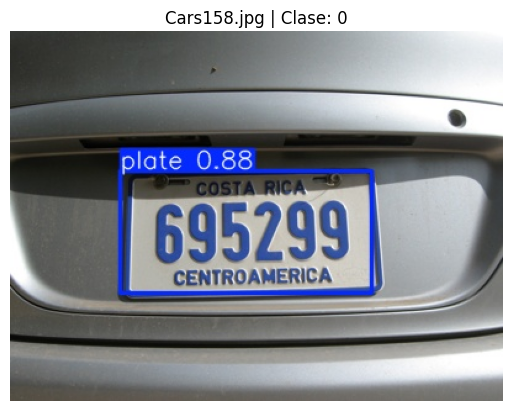

Texto detectado: COSTA RICA
Texto detectado: 695299
Texto detectado: CENTROAMERICA

Procesando imagen: Cars159.jpg


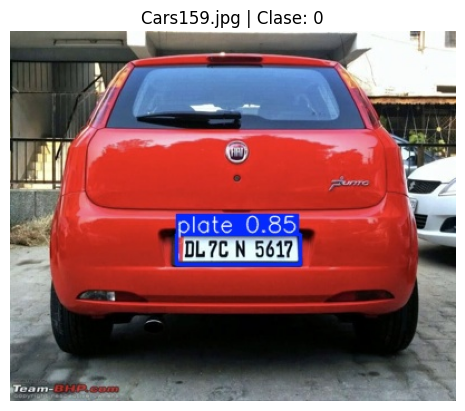

Texto detectado: DLZC N 5617

Procesando imagen: Cars16.jpg


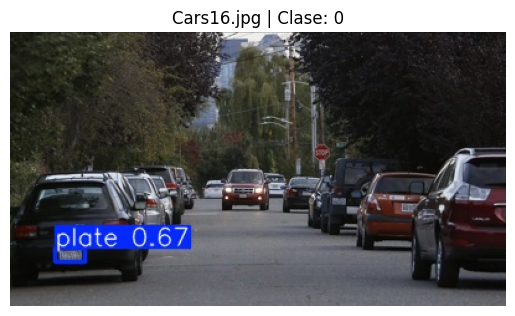

In [ ]:
import cv2
import matplotlib.pyplot as plt
import easyocr
import os

# Rutas a las carpetas de imágenes y etiquetas
img_dir = '/content/runs/detect/predict'
label_dir = '/content/dataset/labels/val'

# Listar los archivos de imagen y ordenarlo
image_files = []

for f in os.listdir(img_dir):
    if f.endswith('.png') or f.endswith('.jpg'):
        image_files.append(f)

image_files = sorted(image_files)[:15]

# Inicializar el lector OCR una sola vez
reader = easyocr.Reader(['en'])

# Procesar las primeras 15 imágenes
for img_file in image_files:
    print(f"\nProcesando imagen: {img_file}")
    img_path = os.path.join(img_dir, img_file)
    label_file = os.path.splitext(img_file)[0] + '.txt'
    label_path = os.path.join(label_dir, label_file)

    # Cargar imagen
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    # Leer las etiquetas
    if not os.path.exists(label_path):
        print("No se encontró el archivo de etiqueta:", label_path)
        continue

    with open(label_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        class_id, x_center, y_center, box_width, box_height = map(float, line.strip().split())

        # Convertir a coordenadas absolutas
        x1 = int(round((x_center - box_width / 2) * w))
        y1 = int(round((y_center - box_height / 2) * h))
        x2 = int(round((x_center + box_width / 2) * w))
        y2 = int(round((y_center + box_height / 2) * h))

        # Asegurarse de que las coordenadas estén dentro de los límites
        x1, y1 = max(0, x1), max(0, y1)
        x2, y2 = min(w, x2), min(h, y2)

        # Recortar ROI
        roi = img_rgb[y1:y2, x1:x2]

        # Mostrar el ROI
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.title(f'{img_file} | Clase: {int(class_id)}')
        plt.show()

        # Aplicar OCR
        results = reader.readtext(roi)

        for detection in results:
            text = detection[1]
            print("Texto detectado:", text)


# **Bibliografia**



*   **Dataset:** https://www.kaggle.com/datasets/andrewmvd/car-plate-detection/data
*   **Repositorio de ejemplo:** https://www.kaggle.com/code/semihberaterdoan/license-plate-recognition-with-yolov11m/notebook
*   **Video sobre YOLO:** https://www.youtube.com/watch?v=ntoRvLgejUY
*   **Tutorial YOLO:** https://www.youtube.com/watch?v=LivJ-lzM-bM


